<a href="https://colab.research.google.com/github/TheeranatSri/DADS7202_project_2/blob/main/Roboflow_Train_YOLOv5_Project2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive

/content/drive/MyDrive


In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
!git reset --hard fbe67e465375231474a2ad80a4389efc77ecff99

fatal: destination path 'yolov5' already exists and is not an empty directory.
fatal: not a git repository (or any parent up to mount point /content)
Stopping at filesystem boundary (GIT_DISCOVERY_ACROSS_FILESYSTEM not set).


In [ ]:
!pip install -q roboflow | grep -v 'already satisfied'
!pip install pytorch-lightning  | grep -v 'already satisfied'
%cd  yolov5
!pip install -qr requirements.txt  | grep -v 'already satisfied'


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
/content/drive/MyDrive/yolov5


In [ ]:
!nvidia-smi -L 

GPU 0: Tesla T4 (UUID: GPU-7613b14c-ecc4-3189-e6e0-8ed539dc4efd)


In [ ]:
from pytorch_lightning import Trainer, seed_everything
from IPython.display import Image, clear_output  # to display images
from utils.downloads import attempt_download  # to download models/datasets
from roboflow import Roboflow
import torch

In [ ]:
#set seed
seed_everything(123, workers=True)
# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))


INFO:pytorch_lightning.utilities.seed:Global seed set to 123


Setup complete. Using torch 1.12.1+cu113 _CudaDeviceProperties(name='A100-SXM4-40GB', major=8, minor=0, total_memory=40536MB, multi_processor_count=108)


In [ ]:
#ดึงรูปภาพจาก roboflow
#Please contact our team if you need api_key
from roboflow import Roboflow
rf = Roboflow(api_key="XXXXXXXXXXXX")
project = rf.workspace("dl-yjboe").project("dads7202_hw2")
dataset = project.version(11).download("yolov5")


loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to DADS7202_HW2-11 in yolov5pytorch:: 100%|██████████| 22476/22476 [02:13<00:00, 168.35it/s]


In [ ]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat {dataset.location}/data.yaml

names:
- Brook
- Chopper
- Franky
- Luffy
- Nami
- Robin
- Sanji
- Usopp
- Zoro
nc: 9
train: DADS7202_HW2-11/train/images
val: DADS7202_HW2-11/valid/images


# Define Model Configuration and Architecture

We will write a yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

You do not need to edit these cells, but you may.

In [ ]:
# define number of classes based on YAML
import yaml
with open(dataset.location + "/data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
#this is the model configuration we will use for our tutorial 
%cat models/yolov5l.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 1.0  # model depth multiple
width_multiple: 1.0  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]], 

In [ ]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
%%writetemplate models/custom_yolov5l.yaml

# parameters
nc: 9  # number of classes
depth_multiple: 1.0  # model depth multiple
width_multiple: 1.0  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]


1. weights ใช้เลือก weights ที่ได้จาก pretrain ถ้าเป็นค่าว่างหมายถึงไม่ใช้ค่าจาก pretrain
2. img ขนาดของภาพ
3. batch ขนาดของ batch
4. freeze freeze layer ตามที่กำหนด

# Weight False Freeze False

In [ ]:
# ปรับ Weight Freeze False ลอง
%%time
!python train.py --img 416 --batch 16 --epochs 100 --data /content/drive/MyDrive/yolov5/DADS7202_HW2-11/data.yaml --cfg ./models/custom_yolov5l.yaml --weights " " --name yolov5l_W_Flase_F_False  --cache

train: weights= , cfg=./models/custom_yolov5l.yaml, data=/content/drive/MyDrive/yolov5/DADS7202_HW2-11/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5l_W_Flase_F_False, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 5 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.2-198-gacff977 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, w

#Weight True Freeze False


In [ ]:
#ไม่ปรับ weight Freeze false
#Pass
%%time
%cd ../content/drive/MyDrive/yolov5
# !python train.py --freeze 24
!python train.py --img 416 --batch 16 --epochs 100 --data /content/drive/MyDrive/yolov5/DADS7202_HW2-11/data.yaml --cfg ./models/custom_yolov5l.yaml --weights yolov5l.pt --name yolov5l_pretrain_results  --cache 

[Errno 2] No such file or directory: '../content/drive/MyDrive/yolov5'
/content/drive/MyDrive/yolov5
train: weights=yolov5s.pt, cfg=, data=data/coco128.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[24], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 5 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.2-198-gacff977 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3

#Weight False Freeze True

In [ ]:
#ปรับ weight Freeze True
# time its performance
#pass
%%time
%cd ../content/drive/MyDrive/yolov5
!python train.py --img 416 --batch 16 --epochs 100 --data /content/drive/MyDrive/yolov5/DADS7202_HW2-11/data.yaml --cfg ./models/custom_yolov5l.yaml --weights " " --name yolov5l_results_freeze  --cache --freeze 24

[Errno 2] No such file or directory: '../content/drive/MyDrive/yolov5'
/content/drive/MyDrive/yolov5
train: weights= , cfg=./models/custom_yolov5l.yaml, data=/content/drive/MyDrive/yolov5/DADS7202_HW2-11/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5l_results_freeze, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[24], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 5 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.2-198-gacff977 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameter

#Weight True Freeze True



In [ ]:
%cd /content/drive/MyDrive/yolov5/runs/train
# %mv yolov5l_pretrain_results yolov5l_W_True_F_False

In [ ]:
#ไม่ปรับ Weight Freeze True
# time its performance
#pass
%%time
!python train.py --img 416 --batch 16 --epochs 100 --data /content/drive/MyDrive/yolov5/DADS7202_HW2-11/data.yaml --cfg ./models/custom_yolov5l.yaml --weights yolov5l.pt --name yolov5l_W_True_F_True  --cache --freeze 24

train: weights=yolov5l.pt, cfg=./models/custom_yolov5l.yaml, data=/content/drive/MyDrive/yolov5/DADS7202_HW2-11/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5l_W_True_F_True, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[24], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 5 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.2-198-gacff977 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentu

In [ ]:
#Rename Floder
# %cd /content/drive/MyDrive/yolov5/runs/train
# %mv yolov5l_W_Flase_F_False   yolov5l_W_Flase_F_False  
# %mv yolov5l_pretrain_results  yolov5l_W_True_F_False  
# %mv yolov5l_results_freeze    yolov5l_W_False F_True
# %mv yolov5l_W_True_F_True     yolov5l_W_True_F_True

#Weight True Freeze 10 


In [ ]:
%cd /content/drive/MyDrive/yolov5/runs/train
# %mv yolov5l_pretrain_results yolov5l_W_True_F_False

/content/drive/MyDrive/yolov5/runs/train


In [ ]:
#ไม่ปรับ Weight Freeze True
# time its performance
%%time
%cd /content/drive/MyDrive/yolov5
!python train.py --img 416 --batch 16 --epochs 100 --data /content/drive/MyDrive/yolov5/DADS7202_HW2-11/data.yaml --cfg ./models/custom_yolov5l.yaml --weights yolov5l.pt --name yolov5l_W_True_F10_True  --cache --freeze 10

/content/drive/MyDrive/yolov5
train: weights=yolov5l.pt, cfg=./models/custom_yolov5l.yaml, data=/content/drive/MyDrive/yolov5/DADS7202_HW2-11/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5l_W_True_F10_True, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[10], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
Command 'git fetch origin' timed out after 5 seconds
requirements: YOLOv5 requirements "ipython" "thop>=0.1.1" not found, attempting AutoUpdate...
remote: Enumerating objects: 31, done.
remote: Counting objects: 100% (31/31), done.
remote: Compressing objects: 100% (17/17), done.
remote: T

In [ ]:
#Rename Floder
# %cd /content/drive/MyDrive/yolov5/runs/train
# %mv yolov5l_W_Flase_F_False   yolov5l_W_Flase_F_False  
# %mv yolov5l_pretrain_results  yolov5l_W_True_F_False  
# %mv yolov5l_results_freeze    yolov5l_W_False F_True
# %mv yolov5l_W_True_F_True     yolov5l_W_True_F_True

#tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/yolov5/runs/train

/bin/bash: line 0: kill: (18705) - No such process
The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 323), started 0:00:26 ago. (Use '!kill 323' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
%cd /content/drive/MyDrive/yolov5/detect.py
!python detect.py --weights /content/drive/MyDrive/yolov5/runs/train/yolov5l_W_False_F_False/weights/best.pt --img 416 --conf 0.4 --source /content/drive/MyDrive/yolov5/DADS7202_HW2-11/test/images

/content/drive/MyDrive/yolov5
detect: weights=['/content/drive/MyDrive/yolov5/runs/train/yolov5l_W_False_F_False/weights/best.pt'], source=/content/drive/MyDrive/yolov5/DADS7202_HW2-11/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-198-gacff977 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
custom_YOLOv5l summary: 267 layers, 46151358 parameters, 0 gradients, 107.8 GFLOPs
image 1/528 /content/drive/MyDrive/yolov5/DADS7202_HW2-11/test/images/004_jpg.rf.095d4053eb3b61c226d6a4bafdab3d2b.jpg: 416x416 1 Brook, 30.6ms
image 2/528 /content/drive/MyDrive/yolov5/DADS7202_HW2-11/test/images/004_j

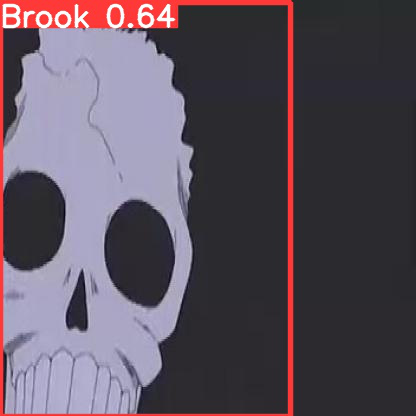

In [ ]:
from PIL import Image
image = Image.open('/content/drive/MyDrive/yolov5/runs/detect/exp9/004_jpg.rf.c670c7daf4aa0b41f6179809a04856c4.jpg')
image

In [ ]:
%cd /content/drive/MyDrive/yolov5/detect.py
!python detect.py --weights /content/drive/MyDrive/yolov5/runs/train/yolov5l_W_False_F_False/weights/best.pt --img 416 --conf 0.4 --source /content/1666279259368.png

[Errno 20] Not a directory: '/content/drive/MyDrive/yolov5/detect.py'
/content/drive/MyDrive/yolov5
detect: weights=['/content/drive/MyDrive/yolov5/runs/train/yolov5l_W_False_F_False/weights/best.pt'], source=/content/1666279259368.png, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-198-gacff977 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
custom_YOLOv5l summary: 267 layers, 46151358 parameters, 0 gradients, 107.8 GFLOPs
image 1/1 /content/1666279259368.png: 320x416 1 Brook, 1 Chopper, 1 Franky, 1 Luffy, 1 Sanji, 31.5ms
Speed: 0.3ms pre-process, 31.5ms inference, 1.4ms NMS per image at shape (1, 3